# Seesaw Balancing
Tianyu Li  
ME314 Final Project

## Initial Setup

- Create useful functions
- Define parameters
- Define variables
- Calculate the Lagrangian

In [15]:
import sympy as sp
from sympy import Matrix, symbols, Function, Eq, solve, eye, zeros
from sympy.abc import t
import numpy as np
import math

def createG(x,y,z,theta):
    G = Matrix([[sp.cos(theta),-sp.sin(theta),0,x],[sp.sin(theta),sp.cos(theta),0,y],[0,0,1,z],[0,0,0,1]])
    return G

def inverseG(G):
    R = G[0:3,0:3]
    p = G[0:3,3]
    inG = Matrix([[R.T, -R.T*p],[0,0,0,1]])
    return inG

def unhatV(V):
    w1 = V[2,1]
    w2 = V[0,2]
    w3 = -V[0,1]
    v1 = V[0,3]
    v2 = V[1,3]
    v3 = V[2,3]
    
    return Matrix([v1,v2,v3,w1,w2,w3])

def createInertia(m,J):
    M = m*eye(3)
    rot = J*eye(3)
    rot[0,0] = 1
    rot[1,1] = 1
    z1 = zeros(3)
    z2 = zeros(3)
    
    M = M.row_join(z1)
    z2 = z2.row_join(rot)
    M = M.col_join(z2)
    
    return M

#parameters
m_ss_val = 1.0
length_val = 1.0
width_val = 0.1
J_ss_val = (1/12)*m_ss_val*((length_val**2)+(width_val**2))
y_ss_val = width_val
m_b_val = 0.1#0.0001
radius_val = 0.1
J_b_val = (1/12)*m_b_val*(((2*radius_val)**2)+(radius_val**2))#(1/2)*m_b_val*radius_val**2
m_d_val = 0.01
d_height = 0.05
J_d_val = m_d_val*d_height*math.cos(math.pi/6)#https://web.physics.wustl.edu/~wimd/HW10.pdf



#seesaw symbols
r_ss = Matrix([0,0,0])
g = symbols('g')
length = symbols('L')
width = symbols('w')
m_ss = symbols('m_ss')
J_ss = symbols('J_ss')
theta_ss = Function("theta_ss")(t)

#block symbols
m_b = symbols('m_b')
J_b = symbols('J_b')
radius = symbols('r_b')
z_b = Function('z_b')(t)

#disturbance symbols
m_d = symbols('m_d')
J_d = symbols('J_d')
x_d = Function('x_d')(t)
y_d = Function('y_d')(t)
theta_d = Function('theta_d')(t)


#seesaw energy
gWS = createG(0,0,0,theta_ss)
vSBhat = inverseG(gWS)*gWS.diff(t)
vSB = unhatV(vSBhat)
inerSB = createInertia(m_ss,J_ss)
KE_ss = sp.simplify(0.5*vSB.T*inerSB*vSB)[0]


#block energy
x_b = z_b*sp.cos(theta_ss)
y_b = z_b*sp.sin(theta_ss)+(width/sp.cos(theta_ss))

gWB1 = createG(x_b,y_b,0,theta_ss)


gHB = createG(z_b,0,0,0)
gSH = createG(0,width,0,0)

gWB = gWS*gSH*gHB

vBBhat = inverseG(gWB)*gWB.diff(t)

vBB = unhatV(vBBhat)
inerBB = createInertia(m_b,J_b)
KE_bb1 = sp.simplify(0.5*vBB.T*inerBB*vBB)[0]
PE_bb = m_b*g*gWB[1,3]#y_b


#disturbance energy
gWD = createG(x_d,y_d,0.0, theta_d)
vDBhat = inverseG(gWD)*gWD.diff(t)
vDB = unhatV(vDBhat)
inerDB = createInertia(m_d,J_d)
KE_dd = sp.simplify(0.5*vDB.T*inerDB*vDB)[0]
PE_dd = m_d*g*y_d


KE = KE_ss+KE_bb1+KE_dd
PE = PE_bb+PE_dd


L = sp.simplify(KE-PE)
display(L)

0.5*J_b*Derivative(theta_ss(t), t)**2 + 0.5*J_d*Derivative(theta_d(t), t)**2 + 0.5*J_ss*Derivative(theta_ss(t), t)**2 - g*m_b*(w*cos(theta_ss(t)) + z_b(t)*sin(theta_ss(t))) - g*m_d*y_d(t) + 0.5*m_b*(w*Derivative(theta_ss(t), t) - Derivative(z_b(t), t))**2 + 0.5*m_b*z_b(t)**2*Derivative(theta_ss(t), t)**2 + 0.5*m_d*Derivative(x_d(t), t)**2 + 0.5*m_d*Derivative(y_d(t), t)**2

## Euler-Lagrange

- Calculate Euler-Lagrange
- Equation of motion

In [16]:
q = Matrix([theta_ss,z_b, x_d,y_d,theta_d])
L_mat = Matrix([L])

dLdq = L_mat.jacobian(q)
ddtdLdqdot1 = L_mat.diff(theta_ss.diff(t)).diff(t)
ddtdLdqdot2 = L_mat.diff(z_b.diff(t)).diff(t)
ddtdLdqdot3 = L_mat.diff(x_d.diff(t)).diff(t)
ddtdLdqdot4 = L_mat.diff(y_d.diff(t)).diff(t)
ddtdLdqdot5 = L_mat.diff(theta_d.diff(t)).diff(t)
ddtdLdqdot = Matrix([ddtdLdqdot1,ddtdLdqdot2,ddtdLdqdot3,ddtdLdqdot4,ddtdLdqdot5]).T

#lhs of the E-L
EL_e = ddtdLdqdot-dLdq
EL_e = sp.simplify(EL_e)


Ft = symbols('Ft')
Fz = symbols('Fz')
F_mat = Matrix([Ft,Fz,0,0,0])

rhs = Matrix([0,0,0,0,0])+F_mat

eqn = Eq(EL_e.T,rhs)
display(eqn)

Eq(Matrix([
[1.0*J_b*Derivative(theta_ss(t), (t, 2)) + 1.0*J_ss*Derivative(theta_ss(t), (t, 2)) - g*m_b*(w*sin(theta_ss(t)) - z_b(t)*cos(theta_ss(t))) + 1.0*m_b*w*(w*Derivative(theta_ss(t), (t, 2)) - Derivative(z_b(t), (t, 2))) + 1.0*m_b*z_b(t)**2*Derivative(theta_ss(t), (t, 2)) + 2.0*m_b*z_b(t)*Derivative(theta_ss(t), t)*Derivative(z_b(t), t)],
[                                                                                                                                                                                                        1.0*m_b*(g*sin(theta_ss(t)) - w*Derivative(theta_ss(t), (t, 2)) - z_b(t)*Derivative(theta_ss(t), t)**2 + Derivative(z_b(t), (t, 2)))],
[                                                                                                                                                                                                                                                                                                          1.0*m_d*Derivativ

In [17]:
dotdot = Matrix([theta_ss.diff(t).diff(t), z_b.diff(t).diff(t), 
                 x_d.diff(t).diff(t),y_d.diff(t).diff(t),theta_d.diff(t).diff(t)])
soln = solve(eqn, dotdot, dict=True)

soln_arr = []
for sol in soln:
    print('Solutions: ')
    for v in dotdot:
        soln_arr.append(sol[v])
        display(sp.Eq(v, sol[v]))

Solutions: 


Eq(Derivative(theta_ss(t), (t, 2)), (Ft + Fz*w - g*m_b*z_b(t)*cos(theta_ss(t)) + m_b*w*z_b(t)*Derivative(theta_ss(t), t)**2 - 2.0*m_b*z_b(t)*Derivative(theta_ss(t), t)*Derivative(z_b(t), t))/(J_b + J_ss + m_b*z_b(t)**2))

Eq(Derivative(z_b(t), (t, 2)), (m_b*w*(Ft + g*m_b*w*sin(theta_ss(t)) - g*m_b*z_b(t)*cos(theta_ss(t)) - 2.0*m_b*z_b(t)*Derivative(theta_ss(t), t)*Derivative(z_b(t), t)) + (Fz - g*m_b*sin(theta_ss(t)) + m_b*z_b(t)*Derivative(theta_ss(t), t)**2)*(J_b + J_ss + m_b*w**2 + m_b*z_b(t)**2))/(m_b*(J_b + J_ss + m_b*z_b(t)**2)))

Eq(Derivative(x_d(t), (t, 2)), 0.0)

Eq(Derivative(y_d(t), (t, 2)), -g)

Eq(Derivative(theta_d(t), (t, 2)), 0.0)

## Impact

- Define phi
- Calculate impact update

In [18]:
c1 = Matrix([0,0,0])
c2 = Matrix([0,0,0])
c3 = Matrix([0,0,0])
corner = [c1,c2,c3]

d_height = 0.05

gdc1 = createG(0,d_height,0,0)
gdc2 = createG(-d_height*sp.cos(sp.pi/6), -d_height*sp.sin(sp.pi/6),0,0)
gdc3 = createG(d_height*sp.cos(sp.pi/6), -d_height*sp.sin(sp.pi/6),0,0)#careful about sp.pi
gdc = [gdc1,gdc2,gdc3]

phi_arr = []
phi_func = []
gSE = createG(0,width/2,0,0)
for i in range(len(corner)):
    c_g = corner[i].row_insert(3,Matrix([1]))
    h_c_g = gWD*gdc[i]*c_g
    h_c_g.row_del(3)
    
    
    phi_c = h_c_g[1]-h_c_g[0]*theta_ss

    phi_arr.append(phi_c)
    display(sp.simplify(phi_c))

    
    phi_c_func = sp.lambdify([q[0],q[1],q[2],q[3],q[4],
                               q[0].diff(t),q[1].diff(t), q[2].diff(t),q[3].diff(t),q[4].diff(t)], phi_arr[i])
    phi_func.append(phi_c_func)

def impact_condition1(s, threshold=1e-2):
    phi_val = phi_func[0](*s)

    seesaw_border = (length_val/2)*math.cos(s[0])+0.05
    if phi_val < threshold and s[2] < seesaw_border and s[2] > -seesaw_border:
        return True
    return False


s_test = [1,1,1,0.01, -0.01, 1, 1,1,1,1]
print(impact_condition1(s_test))

def impact_condition2(s, threshold=1e-2):
    phi_val = phi_func[1](*s)

    seesaw_border = (length_val/2)*math.cos(s[0])+0.05
    if phi_val < threshold and s[2] < seesaw_border and s[2] > -seesaw_border:
        return True
    return False

print(impact_condition2(s_test))

def impact_condition3(s, threshold=1e-2):
    phi_val = phi_func[2](*s)

    seesaw_border = (length_val/2)*math.cos(s[0])+0.05
    if phi_val < threshold and s[2] < seesaw_border and s[2] > -seesaw_border:
        return True
    return False

print(impact_condition3(s_test))


#start dummy

q1 = symbols('q1')
q1dot = symbols('qdot1')
q2 = symbols('q2')
q2dot = symbols('qdot2')
q3 = symbols('q3')
q3dot = symbols('qdot3')
q4 = symbols('q4')
q4dot = symbols('qdot4')
q5 = symbols('q5')
q5dot = symbols('qdot5')

L_dum = L.subs([(q[0].diff(t),q1dot),(q[1].diff(t),q2dot),(q[2].diff(t),q3dot),(q[3].diff(t),q4dot),
                (q[4].diff(t),q5dot),
                (q[0],q1),(q[1],q2),(q[2],q3),(q[3],q4),(q[4],q5)])
L_dum_mat = Matrix([L_dum])
qdot_dum = Matrix([q1dot, q2dot, q3dot, q4dot, q5dot])
dldqdot = L_dum_mat.jacobian(qdot_dum)
H = sp.simplify(dldqdot*qdot_dum-L_dum_mat)

lamb_c1 = symbols('lambda_c1')
lamb_c2 = symbols('lambda_c2')
lamb_c3 = symbols('lambda_c3')
lamb_arr = [lamb_c1,lamb_c2,lamb_c3]

impact_eqn_arr = []
#individual corner impact
for k in range(len(phi_arr)):
    phi_dum1 = phi_arr[k].subs([(q[0],q1),(q[1],q2),(q[2],q3),(q[3],q4),(q[4],q5)])
    phi_dum_mat1 = Matrix([phi_dum1])
    q_dum = Matrix([q1,q2,q3,q4,q5])
    dphidq1 = phi_dum_mat1.jacobian(q_dum)
    

    q1dot_plus = symbols('qdot1^+')
    q2dot_plus = symbols('qdot2^+')
    q3dot_plus = symbols('qdot3^+')
    q4dot_plus = symbols('qdot4^+')
    q5dot_plus = symbols('qdot5^+')


    plus_sub = [(q1dot,q1dot_plus),(q2dot,q2dot_plus),(q3dot,q3dot_plus),(q4dot,q4dot_plus),(q5dot,q5dot_plus)]
    dldqdot_plus1 = dldqdot.subs(plus_sub)
    dphidq_plus1 = dphidq1.subs(plus_sub)
    H_plus1 = H.subs(plus_sub)


    lhs_mat1 = Matrix([dldqdot_plus1.T-dldqdot.T,H_plus1-H])
    rhs_mat1 = Matrix([lamb_arr[k]*dphidq1.T,0])
    eqn1 = Eq(lhs_mat1,rhs_mat1)
    impact_eqn_arr.append(eqn1)
    



-(x_d(t) - 0.05*sin(theta_d(t)))*theta_ss(t) + y_d(t) + 0.05*cos(theta_d(t))

-1.0*theta_ss(t)*x_d(t) + 0.05*theta_ss(t)*cos(theta_d(t) + pi/6) + 1.0*y_d(t) - 0.05*sin(theta_d(t) + pi/6)

-1.0*theta_ss(t)*x_d(t) - 0.05*theta_ss(t)*sin(theta_d(t) + pi/3) + 1.0*y_d(t) - 0.05*cos(theta_d(t) + pi/3)

False
False
False


In [19]:
#start subbing values
import math


lambdify_arr = [theta_ss,z_b,x_d,y_d,theta_d,
            theta_ss.diff(t),z_b.diff(t),x_d.diff(t),y_d.diff(t),theta_d.diff(t)]
def impact_update1():

    
    eqn_sub = [(q1,theta_ss),(q2,z_b),(q3,x_d),(q4,y_d),(q5,theta_d),
               (q1dot,theta_ss.diff(t)),(q2dot,z_b.diff(t)),(q3dot,x_d.diff(t)),(q4dot,y_d.diff(t)),
               (q5dot, theta_d.diff(t)),
               (m_d,m_d_val),(J_d,J_d_val),(J_b,J_b_val),(m_b,m_b_val),(J_ss,J_ss_val),(width,width_val)]

    impact_solns1 = solve(impact_eqn_arr[0], [q1dot_plus, q2dot_plus, q3dot_plus,q4dot_plus,q5dot_plus,lamb_c1], dict=True)

    if impact_solns1[0][lamb_c1] < 0.1:
        impact_solns1 = impact_solns1[1]
    else:
        impact_solns1 = impact_solns1[0]

    q1_update_sol1 = impact_solns1[q1dot_plus].subs(eqn_sub)
    q2_update_sol1 = impact_solns1[q2dot_plus].subs(eqn_sub)
    q3_update_sol1 = impact_solns1[q3dot_plus].subs(eqn_sub)
    q4_update_sol1 = impact_solns1[q4dot_plus].subs(eqn_sub)
    q5_update_sol1 = impact_solns1[q5dot_plus].subs(eqn_sub)
    lamb_update_sol1 = impact_solns1[lamb_c1].subs(eqn_sub)
    

    q1_sol1_func = sp.lambdify(lambdify_arr,q1_update_sol1)
    q2_sol1_func = sp.lambdify(lambdify_arr,q2_update_sol1)
    q3_sol1_func = sp.lambdify(lambdify_arr,q3_update_sol1)
    q4_sol1_func = sp.lambdify(lambdify_arr,q4_update_sol1)
    q5_sol1_func = sp.lambdify(lambdify_arr,q5_update_sol1)
    
    return [q1_sol1_func,q2_sol1_func,q3_sol1_func,q4_sol1_func,q5_sol1_func]




def impact_update2():

    
    eqn_sub = [(q1,theta_ss),(q2,z_b),(q3,x_d),(q4,y_d),(q5,theta_d),
               (q1dot,theta_ss.diff(t)),(q2dot,z_b.diff(t)),(q3dot,x_d.diff(t)),(q4dot,y_d.diff(t)),
               (q5dot, theta_d.diff(t)),
               (m_d,m_d_val),(J_d,J_d_val),(J_b,J_b_val),(m_b,m_b_val),(J_ss,J_ss_val),(width,width_val)]
    print('solving')
    impact_solns1 = solve(impact_eqn_arr[1], [q1dot_plus, q2dot_plus, q3dot_plus,q4dot_plus,q5dot_plus,lamb_c2], dict=True)
    print('finish solving')
    if impact_solns1[0][lamb_c2] < 0.1:
        impact_solns1 = impact_solns1[1]
    else:
        impact_solns1 = impact_solns1[0]

    q1_update_sol1 = impact_solns1[q1dot_plus].subs(eqn_sub)
    q2_update_sol1 = impact_solns1[q2dot_plus].subs(eqn_sub)
    q3_update_sol1 = impact_solns1[q3dot_plus].subs(eqn_sub)
    q4_update_sol1 = impact_solns1[q4dot_plus].subs(eqn_sub)
    q5_update_sol1 = impact_solns1[q5dot_plus].subs(eqn_sub)
    lamb_update_sol1 = impact_solns1[lamb_c2].subs(eqn_sub)
    
    q1_sol1_func = sp.lambdify(lambdify_arr,q1_update_sol1)
    q2_sol1_func = sp.lambdify(lambdify_arr,q2_update_sol1)
    q3_sol1_func = sp.lambdify(lambdify_arr,q3_update_sol1)
    q4_sol1_func = sp.lambdify(lambdify_arr,q4_update_sol1)
    q5_sol1_func = sp.lambdify(lambdify_arr,q5_update_sol1)
    
    return [q1_sol1_func,q2_sol1_func,q3_sol1_func,q4_sol1_func,q5_sol1_func]




def impact_update3():

    
    eqn_sub = [(q1,theta_ss),(q2,z_b),(q3,x_d),(q4,y_d),(q5,theta_d),
               (q1dot,theta_ss.diff(t)),(q2dot,z_b.diff(t)),(q3dot,x_d.diff(t)),(q4dot,y_d.diff(t)),
               (q5dot, theta_d.diff(t)),
               (m_d,m_d_val),(J_d,J_d_val),(J_b,J_b_val),(m_b,m_b_val),(J_ss,J_ss_val),(width,width_val)]

    impact_solns1 = solve(impact_eqn_arr[2], [q1dot_plus, q2dot_plus, q3dot_plus,q4dot_plus,q5dot_plus,lamb_c3], dict=True)

    if impact_solns1[0][lamb_c3] < 0.1:
        impact_solns1 = impact_solns1[1]
    else:
        impact_solns1 = impact_solns1[0]

    q1_update_sol1 = impact_solns1[q1dot_plus].subs(eqn_sub)
    q2_update_sol1 = impact_solns1[q2dot_plus].subs(eqn_sub)
    q3_update_sol1 = impact_solns1[q3dot_plus].subs(eqn_sub)
    q4_update_sol1 = impact_solns1[q4dot_plus].subs(eqn_sub)
    q5_update_sol1 = impact_solns1[q5dot_plus].subs(eqn_sub)
    lamb_update_sol1 = impact_solns1[lamb_c3].subs(eqn_sub)
    
    q1_sol1_func = sp.lambdify(lambdify_arr,q1_update_sol1)
    q2_sol1_func = sp.lambdify(lambdify_arr,q2_update_sol1)
    q3_sol1_func = sp.lambdify(lambdify_arr,q3_update_sol1)
    q4_sol1_func = sp.lambdify(lambdify_arr,q4_update_sol1)
    q5_sol1_func = sp.lambdify(lambdify_arr,q5_update_sol1)
    
    return [q1_sol1_func,q2_sol1_func,q3_sol1_func,q4_sol1_func,q5_sol1_func]

lambdify1 = impact_update1()
print("finish 1")
lambdify2 = impact_update2()
print("finish 2")
lambdify3 = impact_update3()
s_test_plus = [1,1,1,-1,-1,-1,1,1,1,1]
def get_new_impact1(s):
    return np.array([
        s[0],
        s[1],
        s[2],
        s[3],
        s[4],
        lambdify1[0](*s),
        lambdify1[1](*s),
        lambdify1[2](*s),
        lambdify1[3](*s),
        lambdify1[4](*s)
    ])

def get_new_impact2(s):
    return np.array([
        s[0],
        s[1],
        s[2],
        s[3],
        s[4],
        lambdify2[0](*s),
        lambdify2[1](*s),
        lambdify2[2](*s),
        lambdify2[3](*s),
        lambdify2[4](*s)
    ])

def get_new_impact3(s):
    return np.array([
        s[0],
        s[1],
        s[2],
        s[3],
        s[4],
        lambdify3[0](*s),
        lambdify3[1](*s),
        lambdify3[2](*s),
        lambdify3[3](*s),
        lambdify3[4](*s)
    ])


print(get_new_impact1(s_test_plus))
print(get_new_impact2(s_test_plus))
print(get_new_impact3(s_test_plus))

finish 1
solving
finish solving
finish 2
[ 1.          1.          1.         -1.         -1.         -0.94215831
  1.00578417  2.02455453 -0.02455453 -0.63471196]
[ 1.          1.          1.         -1.         -1.         -0.9530563
  1.00469437  1.90679356  0.09320644  1.45031232]
[ 1.          1.          1.         -1.         -1.         -0.95077867
  1.00492213  1.90640553  0.09359447  1.99608154]


## Prepare for simulation
- Lambdify
- Substitute
- Define simulation functions

In [20]:



def integrate(f, xt, dt):

    k1 = dt*f(xt)
    k2 = dt*f(xt+k1/2.)
    k3 = dt*f(xt+k2/2.)
    k4 = dt*f(xt+k3)
    new_xt = xt + (1/6.)*(k1+2.0*k2+2.0*k3+k4)
    return new_xt

def simulate(f, x0, tspan, dt, integrate):

    N = int((max(tspan)-min(tspan))/dt)
    x = np.copy(x0)
    tvec = np.linspace(min(tspan),max(tspan),N)
    xtraj = np.zeros((len(x0),N))
    i = 0
    while i < N:
        
        if impact_condition1(x) is True:
            x = get_new_impact1(x)
            xtraj[:,i]=integrate(f,x,dt)
        elif impact_condition2(x) is True:
            x = get_new_impact2(x)
            xtraj[:,i]=integrate(f,x,dt)
        elif impact_condition3(x) is True:
            x = get_new_impact3(x)
            xtraj[:,i]=integrate(f,x,dt)
        else:
            xtraj[:,i]=integrate(f,x,dt)
        x = np.copy(xtraj[:,i])
        i += 1
    return xtraj 


from math import pi
import math
sub_arr = [(radius,radius_val),(J_b,J_b_val),(m_b,m_b_val),(g,9.8),(J_ss,J_ss_val),(m_ss,m_ss_val),
                                      (length,length_val),(width,width_val),(m_d,m_d_val),(J_d,J_d_val)]
lambdify_arr = [theta_ss,z_b,x_d,y_d,theta_d,
                theta_ss.diff(t),z_b.diff(t),x_d.diff(t),y_d.diff(t),theta_d.diff(t), Ft, Fz]

theta_ss_func_sub = soln_arr[0].subs(sub_arr)
theta_ss_dd = sp.lambdify(lambdify_arr, theta_ss_func_sub)


z_b_func_sub = soln_arr[1].subs(sub_arr)
z_b_dd = sp.lambdify(lambdify_arr, z_b_func_sub)

x_d_func_sub = soln_arr[2].subs(sub_arr)
x_d_dd = sp.lambdify(lambdify_arr, x_d_func_sub)

y_d_func_sub = soln_arr[3].subs(sub_arr)
y_d_dd = sp.lambdify(lambdify_arr, y_d_func_sub)

theta_d_func_sub = soln_arr[4].subs(sub_arr)
theta_d_dd = sp.lambdify(lambdify_arr, theta_d_func_sub)

print('done')

done


## Run simulation

- Calculate control force
- Simulate
- Plot


Generating the simulation result, please wait...


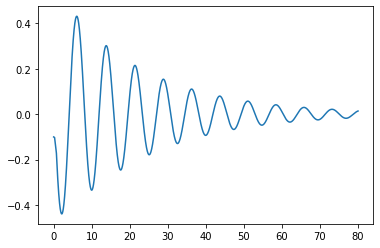

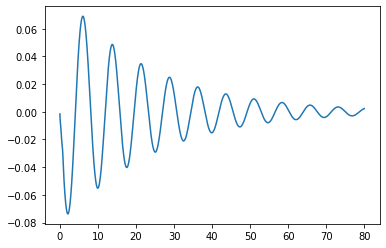

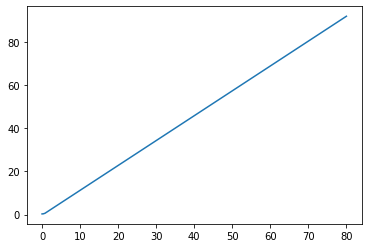

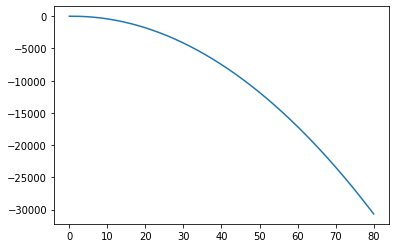

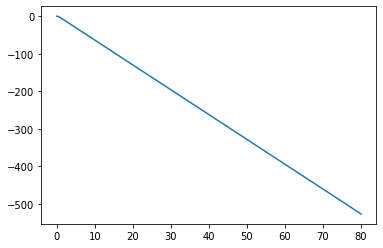

In [21]:

global prev_err
global inte
global prev_z_err
global inte_z
global prev_t_err
global inte_t
prev_err = 0
inte = 0
prev_z_err = 0
inte_z = 0
prev_t_err = 0
inte_t = 0

def pid_seesaw_balance_ball(s):
    global prev_z_err
    global inte_z
    z_error = s[1]
    z_delta_err = (z_error-prev_z_err)/0.01
    inte_z += z_error*0.01
    tar = 0.05*z_error+0.005*z_delta_err+0.0*inte_z
    limit = 0.1
    if tar > limit:
        tar = limit
    if tar < -limit:
        tar = -limit
    
    global prev_err
    global inte

    error = s[0]-tar
    delta_err = (error-prev_err)/0.01
    inte += error*0.01
    g_val = 15
    if s[0] > 0:
        g_val = -g_val
    #tune force
    ft = g_val*m_b_val + 48.0*error+20.0*delta_err+30.1*inte
    
    ft_val = -ft
    
    
    prev_err = error
    prev_z_err = z_error
    
    return ft_val

def pid_block_balance_seesaw(s):
    
    global prev_err
    global inte

    error = s[0]
    delta_err = (error-prev_err)/0.01
    inte += error*0.01
    
    target = 0.1*error+0.001*delta_err
    z_error = s[1]-target
    global prev_z_err
    z_delta_err = (z_error-prev_z_err)/0.01
    global inte_z
    inte_z += z_error*0.01
    
    g_val = 0.0
    if s[0] < 0:
        g_val = g_val
    fz_val = -(g_val*m_b_val+25.5*z_error+35.5*z_delta_err+0.5*inte_z)
    
    prev_z_err = z_error
    return fz_val
    
import random
def dyn(s):


    ft_val = 0.0#pid_seesaw_balance_ball(s)
    fz_val = pid_block_balance_seesaw(s)

        
    theta_ss_dd_func_full_sub = theta_ss_dd(s[0],s[1],s[2],s[3],s[4],s[5],s[6],s[7],s[8],s[9],ft_val, fz_val)
    z_b_dd_func_full_sub = z_b_dd(s[0],s[1],s[2],s[3],s[4],s[5],s[6],s[7],s[8],s[9], ft_val, fz_val)
    
    x_d_dd_func_full_sub = x_d_dd(s[0],s[1],s[2],s[3],s[4],s[5],s[6],s[7],s[8],s[9], ft_val, fz_val)
    y_d_dd_func_full_sub = y_d_dd(s[0],s[1],s[2],s[3],s[4],s[5],s[6],s[7],s[8],s[9], ft_val, fz_val)
    theta_d_dd_func_full_sub = theta_d_dd(s[0],s[1],s[2],s[3],s[4],s[5],s[6],s[7],s[8],s[9], ft_val, fz_val)
    
    

    return np.array([s[5],s[6],s[7],s[8],s[9],
                     theta_ss_dd_func_full_sub, z_b_dd_func_full_sub,x_d_dd_func_full_sub,
                    y_d_dd_func_full_sub,theta_d_dd_func_full_sub])



s0 = np.array([-0.1,0.0,0.3,0.3,0.1,0.0,0.0,0.0,0.0,0.0])
#[0.0,-0.15,0.4,0.5,0.1,0.0,0.0,0.0,0.0,0.0] initial for seesaw balances block
#[-0.1,0.0,0.3,0.3,0.1,0.0,0.0,0.0,0.0,0.0] initial for block balances seesaw

print("Generating the simulation result, please wait...")
sim_t = 80.0
sim_dt = 0.01

traj = simulate(dyn, s0, [0, sim_t], sim_dt, integrate) 
theta_ss_traj = traj[0,:]
z_b_traj = traj[1,:]
x_d_traj = traj[2,:]
y_d_traj = traj[3,:]
theta_d_traj = traj[4,:]


import matplotlib.pyplot as plt

for j in range(5):
    plt.plot(np.linspace(0,sim_t,int(sim_t/sim_dt)),traj[j,:],label='theta_ss')
    plt.show()






## Animation

In [22]:
import numpy as np
def createGnp(x,y,z,theta):
    G = np.array([[np.cos(theta),-np.sin(theta),x],[np.sin(theta),np.cos(theta),y],[0,0,1]])
    return G
def animate_system(theta_array,L=1.0,W=0.1,T=10):
 

    ################################
    # Imports required for animation.
    from plotly.offline import init_notebook_mode, iplot
    from IPython.display import display, HTML
    import plotly.graph_objects as go
    import math

    #######################
    # Browser configuration.
    def configure_plotly_browser_state():
        import IPython
        display(IPython.core.display.HTML('''
            <script src="/static/components/requirejs/require.js"></script>
            <script>
              requirejs.config({
                paths: {
                  base: '/static/base',
                  plotly: 'https://cdn.plot.ly/plotly-1.5.1.min.js?noext',
                },
              });
            </script>
            '''))
    configure_plotly_browser_state()
    init_notebook_mode(connected=False)

    ###############################################
    # Getting data from pendulum angle trajectories.
    N = len(theta_array[0]) # Need this for specifying length of simulation

    ###############################################
    # Define arrays containing data for frame axes
    # In each frame, the x and y axis are always fixed
    x_axis = np.array([0.15, 0.0])
    y_axis = np.array([0.0, 0.15])
    
    x_ori_axis = np.array([0.0,0.0])
    y_ori_axis = np.array([0.0,0.0])
    # Use homogeneous tranformation to transfer these two axes/points
    # back to the fixed frame
    frame_a_x_axis = np.zeros((2,N))
    frame_a_y_axis = np.zeros((2,N))
    frame_a_x_ori_axis = np.zeros((2,N))
    frame_a_y_ori_axis = np.zeros((2,N))
    

    frame_l_x_axis = np.zeros((2,N))
    frame_l_y_axis = np.zeros((2,N))
    frame_l_x_ori_axis = np.zeros((2,N))
    frame_l_y_ori_axis = np.zeros((2,N))
    
    frame_r_x_axis = np.zeros((2,N))
    frame_r_y_axis = np.zeros((2,N))
    frame_r_x_ori_axis = np.zeros((2,N))
    frame_r_y_ori_axis = np.zeros((2,N))
    
    #seesaw rect
    ss_lt = np.zeros((2,N))
    ss_rt = np.zeros((2,N))
    ss_lb = np.zeros((2,N))
    ss_rb = np.zeros((2,N))
    
    #ball frame
    frame_b_x_axis = np.zeros((2,N))
    frame_b_y_axis = np.zeros((2,N))
    frame_b_x_ori_axis = np.zeros((2,N))
    frame_b_y_ori_axis = np.zeros((2,N))
    
    #ball react
    bb_lt = np.zeros((2,N))
    bb_rt = np.zeros((2,N))
    bb_lb = np.zeros((2,N))
    bb_rb = np.zeros((2,N))
    
    #disturbance frame
    frame_d_x_axis = np.zeros((2,N))
    frame_d_y_axis = np.zeros((2,N))
    frame_d_x_ori_axis = np.zeros((2,N))
    frame_d_y_ori_axis = np.zeros((2,N))
    
    #disturbance rect
    dd_t = np.zeros((2,N))
    dd_l = np.zeros((2,N))
    dd_r = np.zeros((2,N))
    
    #support rect
    sp_t = np.zeros((2,N))
    sp_l = np.zeros((2,N))
    sp_r = np.zeros((2,N))
    
    for i in range(N): # iteration through each time step
        t_wa = createGnp(0,0,0,theta_array[0][i])

        frame_a_x_axis[:,i] = t_wa.dot([x_axis[0], x_axis[1], 1])[0:2]
        frame_a_y_axis[:,i] = t_wa.dot([y_axis[0], y_axis[1], 1])[0:2]
        frame_a_x_ori_axis[:,i] = t_wa.dot([x_ori_axis[0], x_ori_axis[1], 1])[0:2]
        frame_a_y_ori_axis[:,i] = t_wa.dot([y_ori_axis[0], y_ori_axis[1], 1])[0:2]
        
        
        t_al = createGnp(-L/2,0,0,0)
        frame_l_x_axis[:,i] = t_wa.dot(t_al.dot([x_axis[0], x_axis[1], 1]))[0:2]
        frame_l_y_axis[:,i] = t_wa.dot(t_al.dot([y_axis[0], y_axis[1], 1]))[0:2]
        frame_l_x_ori_axis[:,i] = t_wa.dot(t_al.dot([x_ori_axis[0], x_ori_axis[1], 1]))[0:2]
        frame_l_y_ori_axis[:,i] = t_wa.dot(t_al.dot([y_ori_axis[0], y_ori_axis[1], 1]))[0:2]

        t_ar = createGnp(L/2,0,0,0)
        frame_r_x_axis[:,i] = t_wa.dot(t_ar.dot([x_axis[0], x_axis[1], 1]))[0:2]
        frame_r_y_axis[:,i] = t_wa.dot(t_ar.dot([y_axis[0], y_axis[1], 1]))[0:2]
        frame_r_x_ori_axis[:,i] = t_wa.dot(t_ar.dot([x_ori_axis[0], x_ori_axis[1], 1]))[0:2]
        frame_r_y_ori_axis[:,i] = t_wa.dot(t_ar.dot([y_ori_axis[0], y_ori_axis[1], 1]))[0:2]
        
        #seesaw rect
        t_ss_lt = createGnp(-L/2,W/2,0,0)
        ss_lt[:,i] = t_wa.dot(t_ss_lt.dot([x_ori_axis[0], x_ori_axis[1], 1]))[0:2]
        
        t_ss_rt = createGnp(L/2,W/2,0,0)
        ss_rt[:,i] = t_wa.dot(t_ss_rt.dot([x_ori_axis[0], x_ori_axis[1], 1]))[0:2]
        
        t_ss_lb = createGnp(-L/2,-W/2,0,0)
        ss_lb[:,i] = t_wa.dot(t_ss_lb.dot([x_ori_axis[0], x_ori_axis[1], 1]))[0:2]
        
        t_ss_rb = createGnp(L/2,-W/2,0,0)
        ss_rb[:,i] = t_wa.dot(t_ss_rb.dot([x_ori_axis[0], x_ori_axis[1], 1]))[0:2]
        
        #support rect
        sp_t[:,i] = [x_ori_axis[0], x_ori_axis[1]]
        
        t_spl = createGnp(-0.07,-0.25,0,0)
        sp_l[:,i] = t_spl.dot([x_ori_axis[0], x_ori_axis[1], 1])[0:2]
        
        t_spr = createGnp(0.07,-0.25,0,0)
        sp_r[:,i] = t_spr.dot([x_ori_axis[0], x_ori_axis[1], 1])[0:2]
        
        
#         #ball frame
#         x_wb = theta_array[1][i]*math.cos(theta_array[0][i])
#         y_wb = theta_array[1][i]*math.sin(theta_array[0][i])+(W/math.cos(theta_array[0][i]))
#         t_wb = createGnp(x_wb,y_wb,0,theta_array[0][i])
#         t_bb1 = createGnp(0,0,0,0)
#         frame_b_x_axis[:,i] = t_wb.dot(t_bb1.dot([x_axis[0], x_axis[1], 1]))[0:2]
#         frame_b_y_axis[:,i] = t_wb.dot(t_bb1.dot([y_axis[0], y_axis[1], 1]))[0:2]
#         frame_b_x_ori_axis[:,i] = t_wb.dot(t_bb1.dot([x_ori_axis[0], x_ori_axis[1], 1]))[0:2]
#         frame_b_y_ori_axis[:,i] = t_wb.dot(t_bb1.dot([y_ori_axis[0], y_ori_axis[1], 1]))[0:2]
        
#         #ball rect
#         t_bb_lt = createGnp(-radius_val,radius_val/2,0,0)
#         bb_lt[:,i] = t_wb.dot(t_bb1.dot(t_bb_lt.dot([x_ori_axis[0], x_ori_axis[1], 1])))[0:2]
        
#         t_bb_rt = createGnp(radius_val,radius_val/2,0,0)
#         bb_rt[:,i] = t_wb.dot(t_bb1.dot(t_bb_rt.dot([x_ori_axis[0], x_ori_axis[1], 1])))[0:2]
        
#         t_bb_lb = createGnp(-radius_val,-radius_val/2,0,0)
#         bb_lb[:,i] = t_wb.dot(t_bb1.dot(t_bb_lb.dot([x_ori_axis[0], x_ori_axis[1], 1])))[0:2]
        
#         t_bb_rb = createGnp(radius_val,-radius_val/2,0,0)
#         bb_rb[:,i] = t_wb.dot(t_bb1.dot(t_bb_rb.dot([x_ori_axis[0], x_ori_axis[1], 1])))[0:2]
        #ball frame
        t_hb = createGnp(theta_array[1][i],0,0,0)
        t_ah = createGnp(0,W,0,0)
        t_wb = t_wa.dot(t_ah.dot(t_hb))
        
        frame_b_x_axis[:,i] = t_wb.dot([x_axis[0], x_axis[1], 1])[0:2]
        frame_b_y_axis[:,i] = t_wb.dot([y_axis[0], y_axis[1], 1])[0:2]
        frame_b_x_ori_axis[:,i] = t_wb.dot([x_ori_axis[0], x_ori_axis[1], 1])[0:2]
        frame_b_y_ori_axis[:,i] = t_wb.dot([y_ori_axis[0], y_ori_axis[1], 1])[0:2]
        
        #ball rect
        t_bb_lt = createGnp(-radius_val,radius_val/2,0,0)
        bb_lt[:,i] = t_wb.dot(t_bb_lt.dot([x_ori_axis[0], x_ori_axis[1], 1]))[0:2]
        
        t_bb_rt = createGnp(radius_val,radius_val/2,0,0)
        bb_rt[:,i] = t_wb.dot(t_bb_rt.dot([x_ori_axis[0], x_ori_axis[1], 1]))[0:2]
        
        t_bb_lb = createGnp(-radius_val,-radius_val/2,0,0)
        bb_lb[:,i] = t_wb.dot(t_bb_lb.dot([x_ori_axis[0], x_ori_axis[1], 1]))[0:2]
        
        t_bb_rb = createGnp(radius_val,-radius_val/2,0,0)
        bb_rb[:,i] = t_wb.dot(t_bb_rb.dot([x_ori_axis[0], x_ori_axis[1], 1]))[0:2]
        
        
        #dis frame
        t_dd = createGnp(theta_array[2][i],theta_array[3][i]+((0.5*W)/math.cos(theta_array[0][i])),
                         0,theta_array[4][i])
        frame_d_x_axis[:,i] = t_dd.dot([x_axis[0], x_axis[1], 1])[0:2]
        frame_d_y_axis[:,i] = t_dd.dot([y_axis[0], y_axis[1], 1])[0:2]
        frame_d_x_ori_axis[:,i] = t_dd.dot([x_ori_axis[0], x_ori_axis[1], 1])[0:2]
        frame_d_y_ori_axis[:,i] = t_dd.dot([y_ori_axis[0], y_ori_axis[1], 1])[0:2]
        
        t_dt = createGnp(0,d_height,0,0)
        dd_t[:,i] = t_dd.dot(t_dt.dot([x_ori_axis[0], x_ori_axis[1], 1]))[0:2]
        
        t_dl = createGnp(-d_height*math.cos(math.pi/6), -d_height*math.sin(math.pi/6),0,0)
        dd_l[:,i] = t_dd.dot(t_dl.dot([x_ori_axis[0], x_ori_axis[1], 1]))[0:2]
        
        t_dr = createGnp(d_height*math.cos(math.pi/6), -d_height*math.sin(math.pi/6),0,0)
        dd_r[:,i] = t_dd.dot(t_dr.dot([x_ori_axis[0], x_ori_axis[1], 1]))[0:2]
                
        

    ####################################
    # Using these to specify axis limits.
    xm = -1.0 #np.min(xx1)-0.5
    xM = 1.0 #np.max(xx1)+0.5
    ym = -1.0 #np.min(yy1)-2.5
    yM = 1.0 #np.max(yy1)+1.5

    ###########################
    # Defining data dictionary.
    # Trajectories are here.
    data=[

        dict(name='Seesaw'),
        dict(name='Sliding Block'),
        dict(name='Disturbance'),
        dict(name='Seesaw Support'),

        ]

    ################################
    # Preparing simulation layout.
    # Title and axis ranges are here.
    layout=dict(autosize=False, width=1000, height=1000,
                xaxis=dict(range=[xm, xM], autorange=False, zeroline=False,dtick=1),
                yaxis=dict(range=[ym, yM], autorange=False, zeroline=False,scaleanchor = "x",dtick=1),
                title='Balancing Seesaw Simulation', 
                hovermode='closest',
                updatemenus= [{'type': 'buttons',
                               'buttons': [{'label': 'Play','method': 'animate',
                                            'args': [None, {'frame': {'duration': T, 'redraw': False}}]},
                                           {'args': [[None], {'frame': {'duration': T, 'redraw': False}, 'mode': 'immediate',
                                            'transition': {'duration': 0}}],'label': 'Pause','method': 'animate'}
                                          ]
                              }]
               )

    ########################################
    # Defining the frames of the simulation.
    # This is what draws the lines from
    # joint to joint of the pendulum.
    frames=[dict(data=[# first three objects correspond to the arms and two masses,
                       # same order as in the "data" variable defined above (thus 
                       # they will be labeled in the same order)
                       dict(x=[ss_lt[0][k],ss_rt[0][k],ss_rb[0][k],ss_lb[0][k],ss_lt[0][k]], 
                            y=[ss_lt[1][k],ss_rt[1][k],ss_rb[1][k],ss_lb[1][k],ss_lt[1][k]], 
                            mode='lines',
                            line=dict(color='blue', width=3),
                            ),
                       dict(x=[bb_lt[0][k],bb_rt[0][k],bb_rb[0][k],bb_lb[0][k],bb_lt[0][k]], 
                            y=[bb_lt[1][k],bb_rt[1][k],bb_rb[1][k],bb_lb[1][k],bb_lt[1][k]], 
                            mode='lines',
                            line=dict(color='orange', width=3),
                            ),
                       dict(x=[dd_t[0][k],dd_r[0][k],dd_l[0][k],dd_t[0][k]], 
                            y=[dd_t[1][k],dd_r[1][k],dd_l[1][k],dd_t[1][k]], 
                            mode='lines',
                            line=dict(color='black', width=3),
                            ),
                       dict(x=[sp_t[0][k],sp_r[0][k],sp_l[0][k],sp_t[0][k]], 
                            y=[sp_t[1][k],sp_r[1][k],sp_l[1][k],sp_t[1][k]], 
                            mode='lines',
                            line=dict(color='blue', width=3),
                            ),
#                        dict(x=[frame_a_x_ori_axis[0][k],frame_a_x_axis[0][k]], 
#                             y=[frame_a_x_ori_axis[1][k],frame_a_x_axis[1][k]], 
#                             mode='lines',
#                             line=dict(color='green', width=3),
#                             ),
#                        dict(x=[frame_a_y_ori_axis[0][k],frame_a_y_axis[0][k]], 
#                             y=[frame_a_y_ori_axis[1][k],frame_a_y_axis[1][k]], 
#                             mode='lines',
#                             line=dict(color='red', width=3),
#                             ),
#                        dict(x=[frame_l_x_ori_axis[0][k],frame_l_x_axis[0][k]], 
#                             y=[frame_l_x_ori_axis[1][k],frame_l_x_axis[1][k]], 
#                             mode='lines',
#                             line=dict(color='green', width=3),
#                             ),
#                        dict(x=[frame_l_y_ori_axis[0][k],frame_l_y_axis[0][k]], 
#                             y=[frame_l_y_ori_axis[1][k],frame_l_y_axis[1][k]], 
#                             mode='lines',
#                             line=dict(color='red', width=3),
#                             ),
#                        dict(x=[frame_r_x_ori_axis[0][k],frame_r_x_axis[0][k]], 
#                             y=[frame_r_x_ori_axis[1][k],frame_r_x_axis[1][k]], 
#                             mode='lines',
#                             line=dict(color='green', width=3),
#                             ),
#                        dict(x=[frame_r_y_ori_axis[0][k],frame_r_y_axis[0][k]], 
#                             y=[frame_r_y_ori_axis[1][k],frame_r_y_axis[1][k]], 
#                             mode='lines',
#                             line=dict(color='red', width=3),
#                             ),
#                        dict(x=[frame_b_x_ori_axis[0][k],frame_b_x_axis[0][k]], 
#                             y=[frame_b_x_ori_axis[1][k],frame_b_x_axis[1][k]], 
#                             mode='lines',
#                             line=dict(color='green', width=3),
#                             ),
#                        dict(x=[frame_b_y_ori_axis[0][k],frame_b_y_axis[0][k]], 
#                             y=[frame_b_y_ori_axis[1][k],frame_b_y_axis[1][k]], 
#                             mode='lines',
#                             line=dict(color='red', width=3),
#                             ),
#                        dict(x=[frame_d_x_ori_axis[0][k],frame_d_x_axis[0][k]], 
#                             y=[frame_d_x_ori_axis[1][k],frame_d_x_axis[1][k]], 
#                             mode='lines',
#                             line=dict(color='green', width=3),
#                             ),
#                        dict(x=[frame_d_y_ori_axis[0][k],frame_d_y_axis[0][k]], 
#                             y=[frame_d_y_ori_axis[1][k],frame_d_y_axis[1][k]], 
#                             mode='lines',
#                             line=dict(color='red', width=3),
#                             ),


                      ]) for k in range(N)]

    #######################################
    # Putting it all together and plotting.
    figure1=dict(data=data, layout=layout, frames=frames)           
    iplot(figure1)

In [23]:
import numpy as np

sim_traj = np.array([theta_ss_traj, z_b_traj, x_d_traj, y_d_traj, theta_d_traj])
print('shape of trajectory: ', sim_traj.shape)

animate_system(sim_traj,L=length_val,W=width_val,T=sim_t)

shape of trajectory:  (5, 8000)
